In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [2]:
import os
os.chdir('/SGRNJ06/randd/USER/zhouyiqi/work/analysis/space/')

In [21]:
# 读取图像
img = cv2.imread('line-recognition/x2.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)






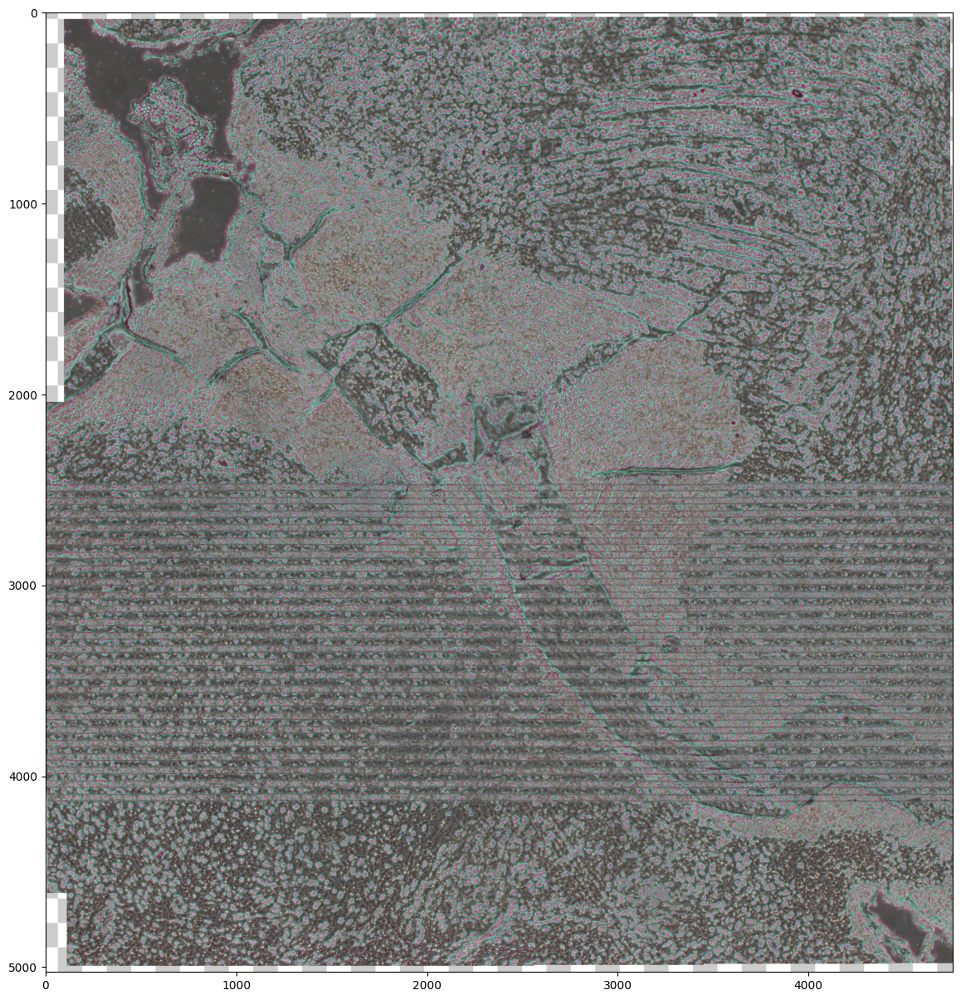

In [55]:
plt.figure(figsize=(15, 15))
plt.imshow(img)

In [22]:
img.shape

(5026, 4757, 3)

In [79]:
# 边缘检测
edges = cv2.Canny(gray, 50, 150, apertureSize=3)


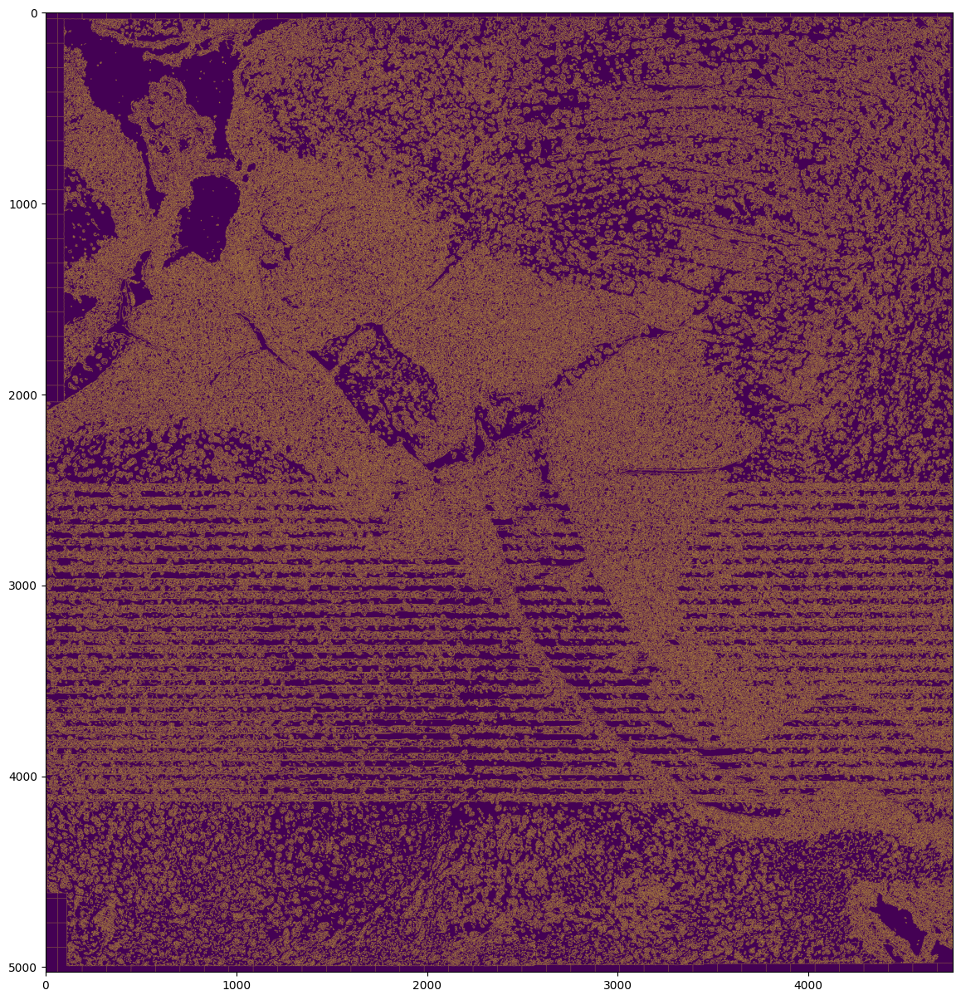

In [81]:
plt.figure(figsize=(15, 15))
plt.imshow(edges)

In [80]:

# 霍夫线变换检测直线
lines = cv2.HoughLines(edges, 1, np.pi/180, threshold=1400)

# 筛选水平线
horizontal_lines = []
height, width = img.shape[:2]

angle_threshold = 1
plot_img = img.copy()
if lines is not None:
    for line in lines:
        rho, theta = line[0]
        angle_deg = np.degrees(theta)

        # 筛选theta 
        if abs(angle_deg-90) <= angle_threshold:
            # 将 (rho, theta) 转换为贯穿图像的直线端点
            a = np.cos(theta)
            b = np.sin(theta)
            x0 = a * rho
            y0 = b * rho

            # 让直线 x 从 0 到 width-1
            x1, x2 = 0, width - 1
            # y = (rho - x*cos(theta)) / sin(theta)
            y1 = int(round((rho - x1 * a) / b))
            y2 = int(round((rho - x2 * a) / b))

            if 0 <= y1 < height and 0 <= y2 < height:
                horizontal_lines.append(((x1, y1), (x2, y2)))
                cv2.line(plot_img, (x1, y1), (x2, y2), (0, 0, 255), 5)






In [77]:
len(horizontal_lines)

733

In [74]:
lines[:2]

array([[[  63.       ,    0.       ]],

       [[-168.       ,    2.3561945]]], dtype=float32)

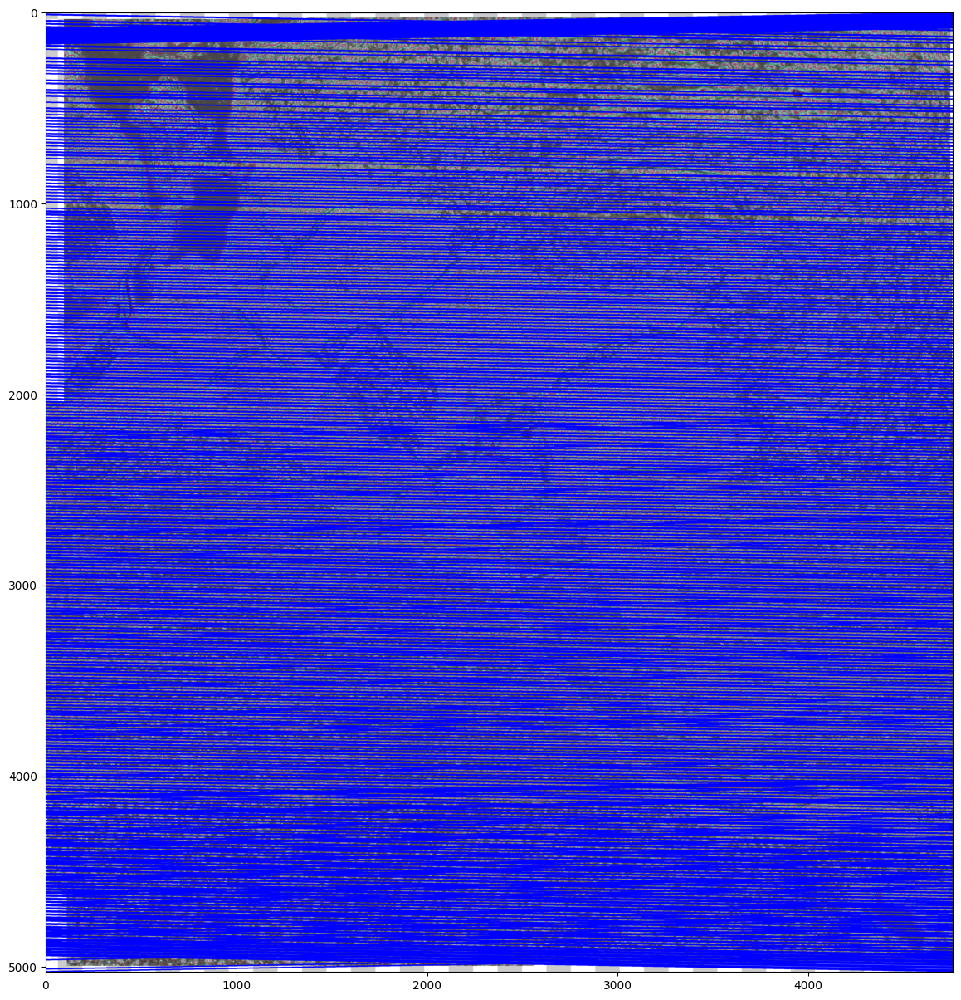

In [78]:

plt.figure(figsize=(15, 15))
plt.imshow(plot_img)

In [27]:
len(horizontal_lines)

1829

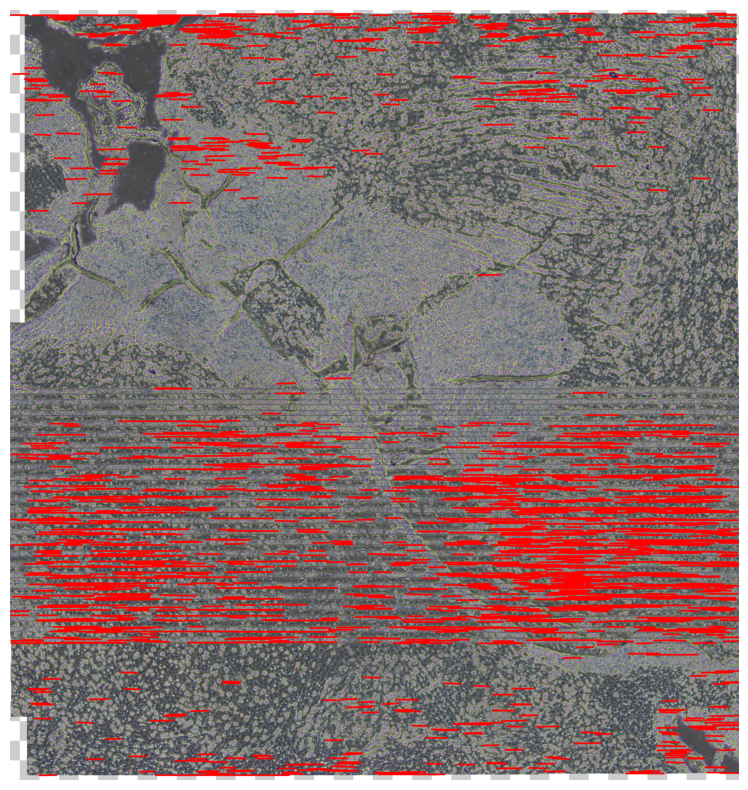

In [29]:
i = img.copy()
# 4. 逐条筛选并画线
for line in horizontal_lines:
    x1,y1,x2,y2 = line
    cv2.line(i, (int(x1), int(y1)), (int(x2), int(y2)), (0, 0, 255), 10)

# 5. 显示
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(i, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [4]:
lsd = cv2.createLineSegmentDetector(0)

In [5]:
lines = lsd.detect(gray)[0]

In [7]:
len(lines)

83546

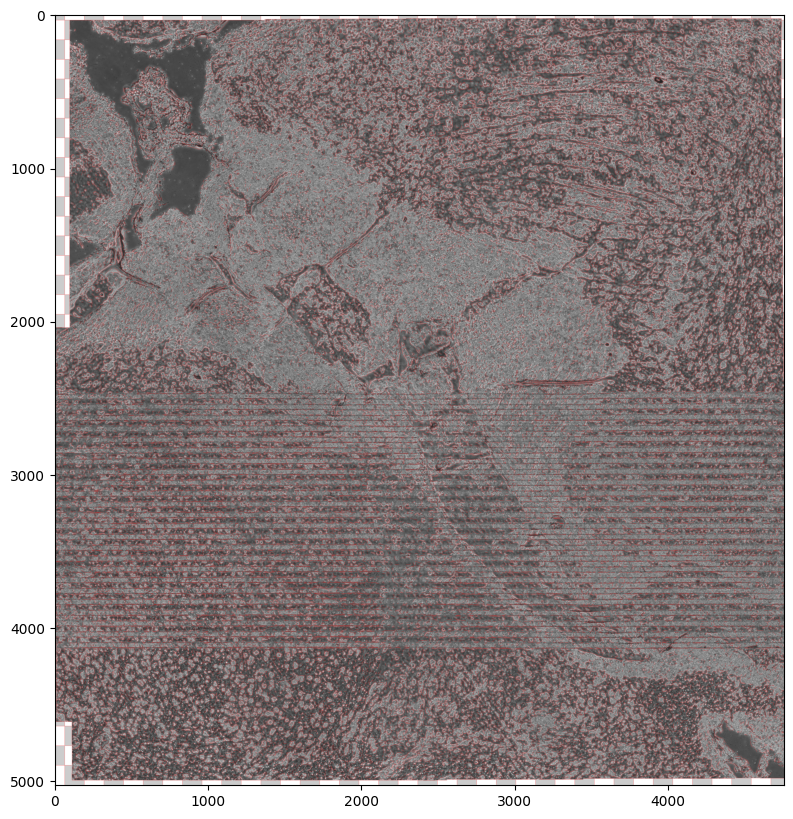

In [9]:
drawn_img = lsd.drawSegments(gray,lines)
drawn_img_rgb = cv2.cvtColor(drawn_img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10, 10)) 
plt.imshow(drawn_img_rgb)

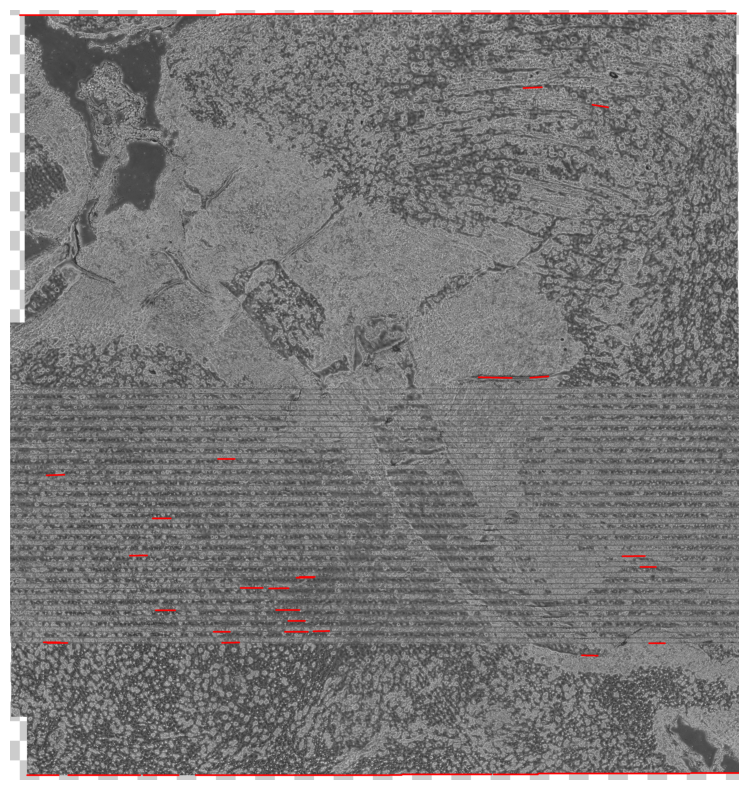

In [16]:
# 2. 转为彩图方便画颜色
color_img = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)
# 3. 设置角度和长度过滤阈值
angle_threshold_deg = 10      # 与水平线夹角小于5度
length_threshold = 100       # 像素长度

# 4. 逐条筛选并画线
for line in lines:
    x1, y1, x2, y2 = line[0]
    dx = x2 - x1
    dy = y2 - y1
    length = np.hypot(dx, dy)

    # 角度计算（和水平线夹角）
    angle = abs(np.degrees(np.arctan2(dy, dx)))

    # 过滤掉非水平线或太短的线
    if angle < angle_threshold_deg or angle > (180 - angle_threshold_deg):
        if length >= length_threshold:
            cv2.line(color_img, (int(x1), int(y1)), (int(x2), int(y2)), (0, 0, 255), 10)

# 5. 显示
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(color_img, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

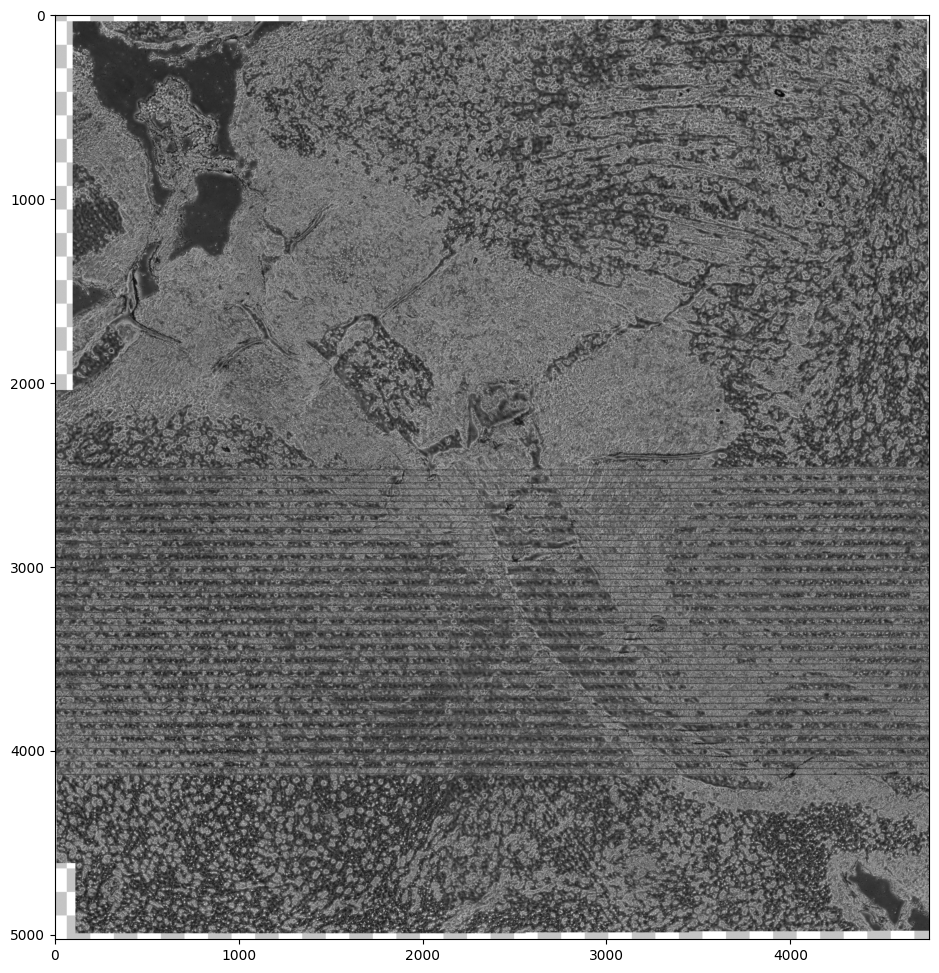

In [33]:
plt.figure(figsize=(12, 12)) 
plt.imshow(gray, cmap='gray')

In [14]:
#blurred = cv2.GaussianBlur(gray, (5,5), 0)



array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], shape=(5026, 4757), dtype=uint8)

In [18]:
edges = cv2.Canny(gray, threshold1=30, threshold2=150)

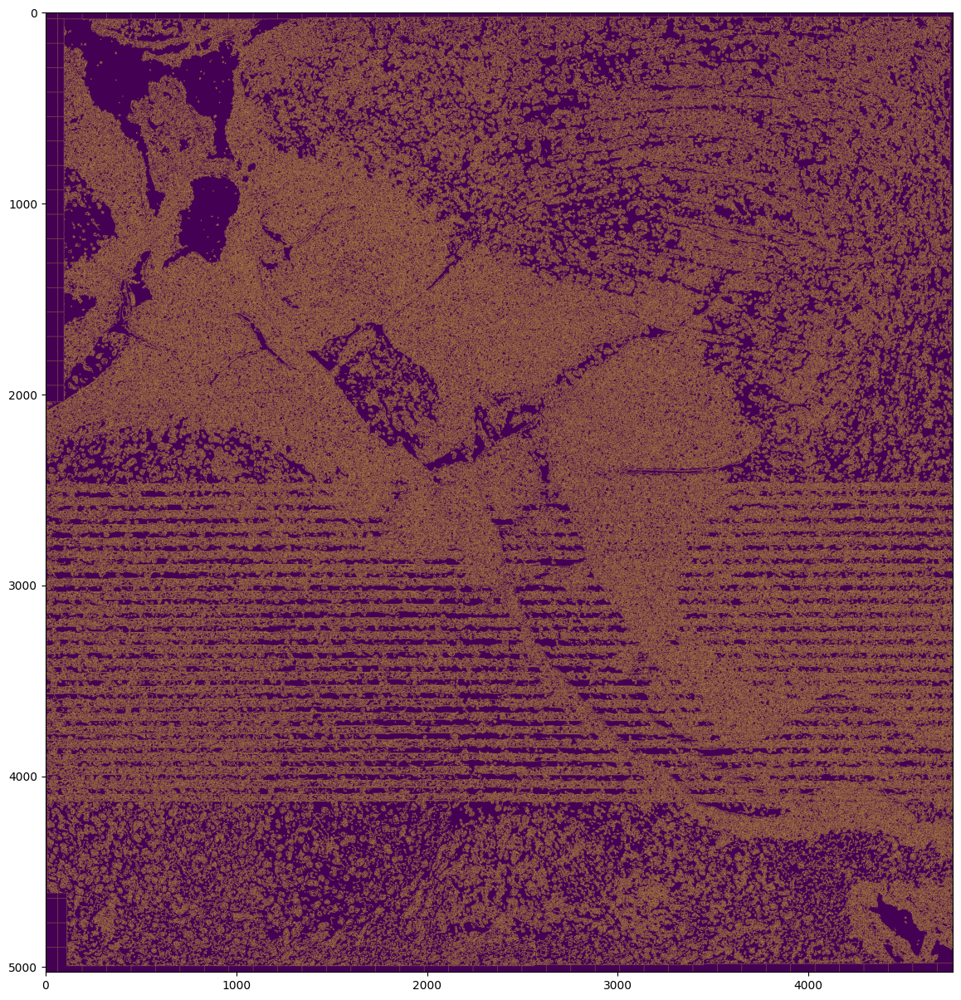

In [19]:
plt.figure(figsize=(15,15)) 
plt.imshow(edges)

In [25]:
lines = cv2.HoughLinesP(gray, 1, np.pi/180, threshold=1000, 
                        minLineLength=5000, maxLineGap=10)
lines

array([[[   5, 5024,    5,    1]]], dtype=int32)

In [30]:
lines

array([[[   5, 5024,    5,    1]]], dtype=int32)

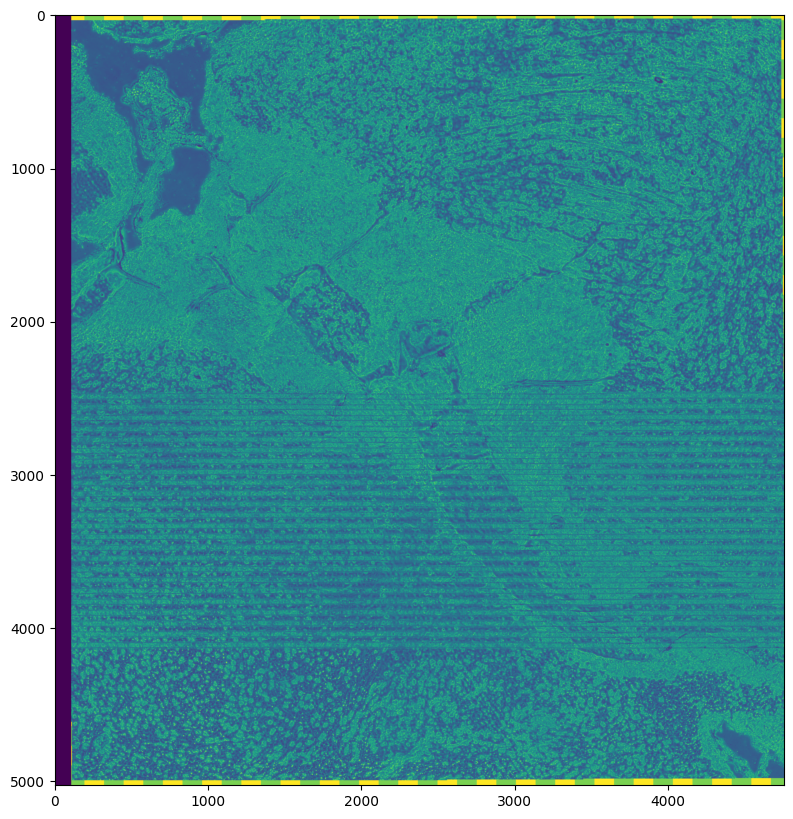

In [31]:
image = gray.copy()
for line in lines:
    x1, y1, x2, y2 = line[0]
    cv2.line(image, (x1, y1), (x2, y2), (0, 0, 255), 200)

plt.figure(figsize=(10, 10))
plt.imshow(image)

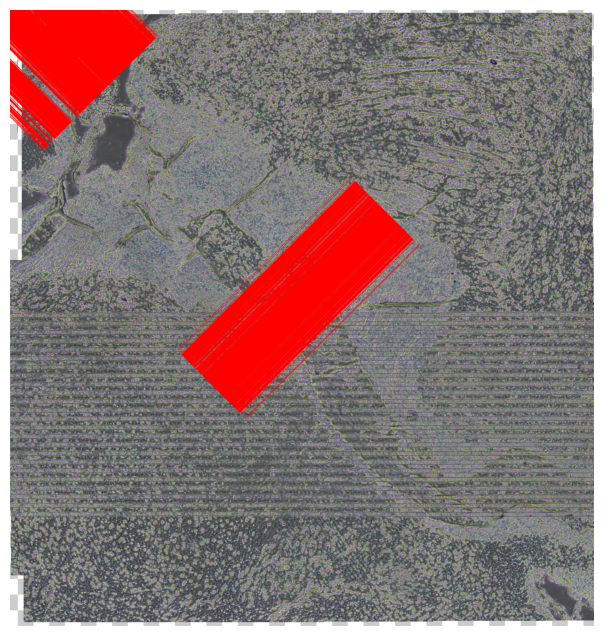

In [28]:
# 创建副本绘图
img_lines = img.copy()
line_angle = 50

# 遍历所有检测到的直线
for line in lines:
    rho, theta = line[0]

    # 只保留近似水平线（theta ~ 0 或 pi）
    if abs(theta) < np.deg2rad(line_angle) or abs(theta - np.pi) < np.deg2rad(line_angle):
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a * rho
        y0 = b * rho
        # 转为两端点坐标
        x1 = int(x0 + 1000 * (-b))
        y1 = int(y0 + 1000 * (a))
        x2 = int(x0 - 1000 * (-b))
        y2 = int(y0 - 1000 * (a))
        cv2.line(img_lines, (x1, y1), (x2, y2), (0, 0, 255), 2)

# 显示结果
plt.figure(figsize=(12, 8))
plt.imshow(cv2.cvtColor(img_lines, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

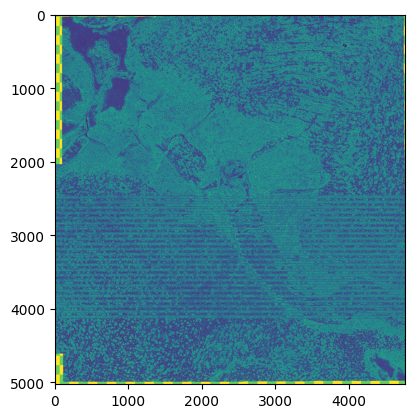

In [10]:
plt.imshow(gray)

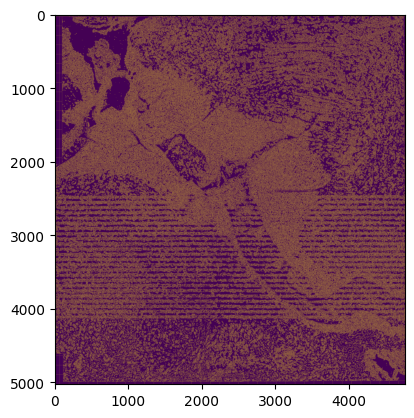

In [6]:
plt.imshow(edges)

In [7]:
lines = cv2.HoughLines(edges, 1, np.pi / 180, threshold=300)

In [ ]:
if lines is not None:
    for rho, theta in lines[:,0]:
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a * rho
        y0 = b * rho
        x1 = int(x0 + 1000*(-b))
        y1 = int(y0 + 1000*(a))
        x2 = int(x0 - 1000*(-b))
        y2 = int(y0 - 1000*(a))
        cv2.line(img, (x1,y1), (x2,y2), (0,0,255), 2)